<a href="https://colab.research.google.com/github/namo507/SURV-622-LLM-files/blob/main/SURV_622_SURVMETH_622_L8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🧪 Text Analysis Demo (in R)
Welcome! This section demonstrates **text analysis using R**. Even if you're new to coding, don't worry — each step includes explanations.

We’ll use R code inside a Python notebook using Colab’s `rpy2` support.

In [ ]:
%load_ext rpy2.ipython

In [ ]:
%%R
# Install required R packages
if (!require('tidyverse')) install.packages('tidyverse', repos='http://cran.us.r-project.org')
if (!require('tm')) install.packages('tm', repos='http://cran.us.r-project.org')
if (!require('word2vec')) install.packages('word2vec', repos='http://cran.us.r-project.org')
if (!require('udpipe')) install.packages('udpipe', repos='http://cran.us.r-project.org')
if (!require('uwot')) install.packages('uwot', repos='http://cran.us.r-project.org')


Loading required package: uwot
Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)
also installing the dependencies ‘RcppEigen’, ‘sitmo’, ‘FNN’, ‘irlba’, ‘RcppAnnoy’, ‘RSpectra’, ‘dqrng’

trying URL 'http://cran.us.r-project.org/src/contrib/RcppEigen_0.3.4.0.2.tar.gz'
Content type 'application/x-gzip' length 1761745 bytes (1.7 MB)
downloaded 1.7 MB

trying URL 'http://cran.us.r-project.org/src/contrib/sitmo_2.0.2.tar.gz'
Content type 'application/x-gzip' length 132964 bytes (129 KB)
downloaded 129 KB

trying URL 'http://cran.us.r-project.org/src/contrib/FNN_1.1.4.1.tar.gz'
Content type 'application/x-gzip' length 78809 bytes (76 KB)
downloaded 76 KB

trying URL 'http://cran.us.r-project.org/src/contrib/irlba_2.3.5.1.tar.gz'
Content type 'application/x-gzip' length 233555 bytes (228 KB)
downloaded 228 KB

trying URL 'http://cran.us.r-project.org/src/contrib/RcppAnnoy_0.0.22.tar.gz'
Content type 'application/x-gzip' length 156284 bytes (152 KB)
downloaded 15

In [ ]:
# Install required Python packages
!pip install transformers torch bertviz gdown

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 62.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 49.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 38.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 84.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 157.6/157.6 kB 11.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.6/139.6 kB 10.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Download external data (e.g., model file)

# Download model.zip from Google Drive
!gdown --id 1yQQ6sBvooaSMrJKq62uAFORCnAJcXuYD --output files.zip

# Unzip
!unzip -q files.zip


/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1yQQ6sBvooaSMrJKq62uAFORCnAJcXuYD
From (redirected): https://drive.google.com/uc?id=1yQQ6sBvooaSMrJKq62uAFORCnAJcXuYD&confirm=t&uuid=1c2b94bf-a240-445f-aa00-8fdb48578520
To: /content/files.zip
100% 650M/650M [00:14<00:00, 46.1MB/s]
replace inClassDemo/Python/demo.ipynb? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
A


### Bag of words demo

this is a demo for class surv 622/survmeth 622. it contains two sections: bag of words model and word2vec model for representation learning.

In [ ]:
%%R
#Load Packages
#install.packages(c('tm','word2vec','udpipe', 'uwot','glmnet', 'plotly'))
library(tm)
library(ggplot2)
library(word2vec)
library(uwot)
cos.sim <- function(a,b)
{
    return(sum(a*b)/sqrt(sum(a^2)*sum(b^2)) )
}

Loading required package: Matrix

Attaching package: ‘Matrix’

The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack



### Read the data

data are downloaded from kaggle (https://www.kaggle.com/datasets/kazanova/sentiment140). the tweets have been annotated (0 = negative, 4 = positive) and they can be used to detect sentiment.

In [ ]:
%%R
tweets = read.csv("inClassDemo/R/training.100000.processed.noemoticon.csv",stringsAsFactors=FALSE, encoding = "UTF-8")

### Check the text

the data has been prepossessed. let's take a look.

In [ ]:
%%R
head(tweets)

  target        ids                         date     flag           user
1      4 2053333385 Sat Jun 06 04:10:15 PDT 2009 NO_QUERY        meggz15
2      0 1964093465 Fri May 29 13:42:51 PDT 2009 NO_QUERY  BattleBabeeyx
3      4 1980616407 Sun May 31 07:13:44 PDT 2009 NO_QUERY mrswilliams815
4      4 2174460574 Sun Jun 14 22:35:57 PDT 2009 NO_QUERY     abbiereyes
5      0 1754448486 Sun May 10 06:18:29 PDT 2009 NO_QUERY         cradow
6      4 2174736346 Sun Jun 14 23:11:51 PDT 2009 NO_QUERY       aurattii
                                                                                             text
1                                                                    is spendingg time with ness 
2                                                 @buckhollywood aw it was so sad  shes too cute!
3                                                                        Back to Barstow today!! 
4                                            @thedailysurvey vote ko po touch my hand.  thanks po

### Check missing data

In [ ]:
%%R
sum(is.na(tweets$target))
sum(is.na(tweets$ids))
sum(is.na(tweets$text))

[1] 0


### This line is to address some encoding error.

In [ ]:
%%R
tweets$text = iconv(tweets$text,"WINDOWS-1252","UTF-8")

### Create a document-term matrix
prepossessing road map:
1. lower all character
2. remove numbers
3. remove punctuation
4. remove stop words

In [ ]:
%%R
tweet_corpus = Corpus(VectorSource(tweets$text))

In [ ]:
%%R
tweet_corpus = tm_map(tweet_corpus, content_transformer(tolower))
tweet_corpus = tm_map(tweet_corpus, removeNumbers)
tweet_corpus = tm_map(tweet_corpus, removePunctuation)
tweet_corpus = tm_map(tweet_corpus, removeWords, c("the", "and", stopwords("english")))
tweet_corpus =  tm_map(tweet_corpus, stripWhitespace)

In addition: Warning messages:
1: In tm_map.SimpleCorpus(tweet_corpus, content_transformer(tolower)) :
  transformation drops documents
2: In tm_map.SimpleCorpus(tweet_corpus, removeNumbers) :
  transformation drops documents
3: In tm_map.SimpleCorpus(tweet_corpus, removePunctuation) :
  transformation drops documents
4: In tm_map.SimpleCorpus(tweet_corpus, removeWords, c("the", "and",  :
  transformation drops documents
5: In tm_map.SimpleCorpus(tweet_corpus, stripWhitespace) :
  transformation drops documents


### Convert word vector to document-term matrix

In [ ]:
%%R
tweet_dtm = DocumentTermMatrix(tweet_corpus)
tweet_dtm

<<DocumentTermMatrix (documents: 100000, terms: 106638)>>
Non-/sparse entries: 729548/10663070452
Sparsity           : 100%
Maximal term length: 141
Weighting          : term frequency (tf)


### Take a quick look at first 15 documents and terms.

In [ ]:
%%R
inspect(tweet_dtm[1:15, 1:15])

<<DocumentTermMatrix (documents: 15, terms: 15)>>
Non-/sparse entries: 19/206
Sparsity           : 92%
Maximal term length: 14
Weighting          : term frequency (tf)
Sample             :
    Terms
Docs back barstow buckhollywood cute ness sad shes spendingg time today
  1     0       0             0    0    1   0    0         1    1     0
  15    0       0             0    0    0   0    0         0    1     1
  2     0       0             1    1    0   1    1         0    0     0
  3     1       1             0    0    0   0    0         0    0     1
  4     0       0             0    0    0   0    0         0    0     0
  5     0       0             0    0    0   0    0         0    0     0
  6     0       0             0    0    0   0    0         0    0     0
  7     0       0             0    0    0   0    0         0    0     0
  8     1       0             0    0    0   0    0         0    0     1
  9     0       0             0    0    0   0    0         0    0     0


### Drop most of the rare terms to make the matrix dense.

In [ ]:
%%R
tweet_dtm = removeSparseTerms(tweet_dtm, 0.99)

In [ ]:
%%R
tweet_dtm

<<DocumentTermMatrix (documents: 100000, terms: 88)>>
Non-/sparse entries: 194642/8605358
Sparsity           : 98%
Maximal term length: 8
Weighting          : term frequency (tf)


### Implement latent semantic analysis (lsa)

In [ ]:
%%R
tweet_svd = svd(tweet_dtm)

### Review the latent topic for the first 15 documents.

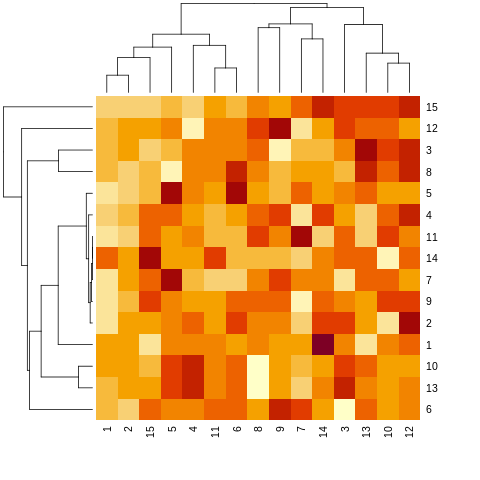

In [ ]:
%%R
heatmap(tweet_svd$u[1:15,1:15])

### Word2vec
## start from the scratch
we will build a word2vec by ourselves using cbow architecture in the context of tweets we have seen.

## train the model

In [ ]:
%%R
set.seed(1015)
model = word2vec(x = tweets$text, type = "cbow", dim = 15, iter = 10)

### Visulize the word relation using umap

In [ ]:
%%R -o df
embedding = as.matrix(model)
viz = umap(embedding, n_neighbors = 15, n_threads = 2)
df  = data.frame(
  word = gsub("//.+", "", rownames(embedding)),
  xpos = gsub(".+//", "", rownames(embedding)),
  x = viz[, 1],
  y = viz[, 2],
  stringsAsFactors = FALSE
)




In [ ]:
# Since rpy2 cannot directed convey the plotly object, we need to convert it to python code first
from rpy2.robjects import pandas2ri
import rpy2.robjects as robjects

# Activate pandas conversion
pandas2ri.activate()

# Pull the R dataframe directly
df_r = robjects.globalenv['df']
df1 = pandas2ri.rpy2py(df_r)

# Now plot with Plotly
import plotly.express as px

fig = px.scatter(df1[500:700], x='x', y='y', text='word')
fig.update_traces(textposition='top center')
fig.update_layout(title='UMAP Word Embeddings')
fig.show()




### Using pretrained word2vec model

In [ ]:
%%R
model = read.word2vec("inClassDemo/R/18/model.bin", normalize = TRUE)

### Select any word and its neighbors (in terms of sematic similarity)

In [ ]:
%%R
predict(model, newdata = c("fries", "money"), type = "nearest", top_n = 5)

$fries
  term1      term2 similarity rank
1 fries     french  0.9076371    1
2 fries    burgers  0.8938329    2
3 fries hamburgers  0.8827033    3
4 fries sandwiches  0.8591300    4
5 fries      fried  0.8587483    5

$money
  term1  term2 similarity rank
1 money monies  0.8541762    1
2 money  funds  0.8506691    2
3 money   cash  0.8144652    3
4 money   sums  0.8034646    4
5 money   fund  0.7885280    5



### Arithmetic of word vector

In [ ]:
%%R
wv = predict(model, newdata = c("king", "man", "woman"), type = "embedding")
wv = wv["king", ] - wv["man", ] + wv["woman", ]
predict(model, newdata = wv, type = "nearest", top_n = 3)

     term similarity rank
1    king  0.9670773    1
2   queen  0.9044872    2
3 monarch  0.8917280    3


### Implicit stereotype
let check the word *nurse* will more similar to *man* or *woman*

In [ ]:
%%R
wv_woman = predict(model, newdata = c("woman"), type = "embedding")
wv_man = predict(model, newdata = c("man"), type = "embedding")
wv_nurse = predict(model, newdata = c("nurse"), type = "embedding")
print(cos.sim(wv_woman, wv_nurse))
print(cos.sim(wv_man, wv_nurse))

[1] 0.5568123
[1] 0.3725856


# 🐍 Python Text Analysis Demo
Now, we’ll look at a similar demo using **Python**. The goal is to help you see how similar tasks can be accomplished in both languages.

Don't worry if Python is new — just follow along and observe the structure.

### In-class demo

author: [mao li](maolee@umich.edu)

description: this is a simple in-class demo for better understanding of transformer model and its attention mechanism. we also extend the transformer model to a its variant, the bert model and gpt mode

### Note: to run this notebook, you need to install the following packages:

- `transformers`
- `torch`
- `bertviz`

Let's first start with the transformer encoder model. The transformer model is a deep learning model that is based on the attention mechanism. The attention mechanism is a mechanism that allows the model to focus on different parts of the input sequence when making predictions. The transformer model is composed of an encoder and a decoder. The encoder is responsible for processing the input sequence and extracting its features, while the decoder is responsible for generating the output sequence based on the features extracted by the encoder.

The most famous transformer model is the BERT model, which is a pre-trained transformer model that has been fine-tuned on a large corpus of text. The BERT model has been shown to achieve state-of-the-art performance on a wide range of natural language processing tasks, including text classification, named entity recognition, and question answering.

Let's see how the attention mechanism works in the transformer model.

> 💡 *Tip: Take your time to read the comments and try changing the code to see what happens!*

## What is BERTViz?
BERTViz is a tool for visualizing how attention works inside models like BERT. It shows you which words the model focuses on when reading a sentence.

Think of attention like this:

"When the model reads a word, it looks around to find other words that help it understand the meaning."

BERT has many layers and heads. Each "head" learns a different relationship between words — like syntax, co-reference, emphasis, etc.

## How to Interpret the Results
Once the visualization appears:

- You’ll see each layer of BERT as a horizontal section.

- Inside each layer, you can click on different attention heads.

- Hover over a word (like "chased") — the highlighted lines show which other words this word attends to.

  - If “chased” attends to “dog” and “cat,” that means the model sees a relationship.

  - You can see long-distance dependencies, like between subject and verb.

Each head learns a different pattern:

- Some heads may capture grammatical structure

- Others may capture semantic relationships

- You can look at how these change layer by layer

In [ ]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

model_type = "bert"
model_version = "bert-base-uncased"
do_lower_case = True
model = BertModel.from_pretrained(model_version)
tokenizer = BertTokenizer.from_pretrained(
    model_version,
)
sentence_a = "John is taller than Mary."
sentence_b = "Mary is taller than John."
show(
    model,
    model_type,
    tokenizer,
    sentence_a,
    sentence_b,
    layer=2,
    head=0,
)

100%|██████████| 231508/231508 [00:00<00:00, 19493594.52B/s]


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Let's now check whether attention can capture subject and verb when there is a long distance between them.

In [ ]:
# Head view
from bertviz import head_view
from transformers import AutoTokenizer, AutoModel

model_version = "bert-base-uncased"
model = AutoModel.from_pretrained(model_version, output_attentions=True)
tokenizer = AutoTokenizer.from_pretrained(model_version)
sentence = "Daenerys, Stormborn of the House Targaryen, the First of Her Name, The Unburnt, Queen of the Andals, Breaker of Chains and Mother of Dragons is knocking your door. "
inputs = tokenizer.encode(sentence, return_tensors="pt")
outputs = model(inputs)
attention = outputs[-1]  # Output includes attention weights when output_attentions=True
tokens = tokenizer.convert_ids_to_tokens(inputs[0])
head_view(attention, tokens)

BertSdpaSelfAttention is used but `torch.nn.functional.scaled_dot_product_attention` does not support non-absolute `position_embedding_type` or `output_attentions=True` or `head_mask`. Falling back to the manual attention implementation, but specifying the manual implementation will be required from Transformers version v5.0.0 onwards. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.


<IPython.core.display.Javascript object>

In [ ]:
# Head view
from bertviz import head_view
from transformers import AutoTokenizer, AutoModel

model_version = "albert/albert-base-v2"
model = AutoModel.from_pretrained(model_version, output_attentions=True)
tokenizer = AutoTokenizer.from_pretrained(model_version)
sentence = "The animal didn't cross the street because it was too wide."
inputs = tokenizer.encode(sentence, return_tensors="pt")
outputs = model(inputs)
attention = outputs[-1]  # Output includes attention weights when output_attentions=True
tokens = tokenizer.convert_ids_to_tokens(inputs[0])
head_view(attention, tokens)

AlbertSdpaAttention is used but `torch.nn.functional.scaled_dot_product_attention` does not support non-absolute `position_embedding_type` or `output_attentions=True` or `head_mask`. Falling back to the eager attention implementation, but specifying the eager implementation will be required from Transformers version v5.0.0 onwards. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.
AlbertSdpaAttention is used but `torch.nn.functional.scaled_dot_product_attention` does not support non-absolute `position_embedding_type` or `output_attentions=True` or `head_mask`. Falling back to the eager attention implementation, but specifying the eager implementation will be required from Transformers version v5.0.0 onwards. This warning can be removed using the argument `attn_implementation="eager"` when loading the model.
AlbertSdpaAttention is used but `torch.nn.functional.scaled_dot_product_attention` does not support non-absolute `position_embeddi

<IPython.core.display.Javascript object>

### Next, we would like to see whether attention can differentiate same words in different contexts.

In [ ]:
from transformers import AutoModel, AutoTokenizer

model_id = "bert-base-uncased"
model = AutoModel.from_pretrained(model_id)
tokenizer = AutoTokenizer.from_pretrained(model_id)
word1 = "river bank"
word2 = "savings bank"
word1_token = tokenizer(word1, return_tensors="pt")
word2_token = tokenizer(word2, return_tensors="pt")
embedding1 = model(**word1_token)
embedding2 = model(**word2_token)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

In [ ]:
print(word1_token["input_ids"])
print(word2_token["input_ids"])

tensor([[ 101, 2314, 2924,  102]])
tensor([[  101, 10995,  2924,   102]])


In [ ]:
print(tokenizer.decode(word1_token['input_ids'][0]))


[CLS] river bank [SEP]


In [ ]:
embedding1['last_hidden_state'].shape

torch.Size([1, 4, 768])

In [ ]:
embedding1['pooler_output'].shape

torch.Size([1, 768])

In [ ]:
# cosine similarity for word "bank"
import torch

cos = torch.nn.CosineSimilarity(dim=0, eps=1e-6)
test_word = "deposit"
test_word_token = tokenizer(test_word, return_tensors="pt")
embedding3 = model(**test_word_token)
print(
    f"similarity between {word1} and {test_word}: {cos(embedding1['last_hidden_state'][0][2], embedding3['last_hidden_state'][0][1])}"
)
print(
    f"similarity between {word2} and {test_word}: {cos(embedding2['last_hidden_state'][0][2], embedding3['last_hidden_state'][0][1])}"
)

similarity between river bank and deposit: 0.42700862884521484
similarity between savings bank and deposit: 0.5335708856582642
